# RF-DETR + classification

Вся выжимка из анализа набора данных при помощи "пристального взгляда" описана в ```README.md```. Также там есть размышления по решению данной задачи через **эвристику**, **просто YOLO**, **YOLO + padding**

**ОБЯЗАТЕЛЬНО ПРОЧТИТЕ ```README.md```!!!**

## Задача
Определить количество книг на фотографии.

## Размышления
У подхода **YOLO + padding + classification** есть заметные проблемы, такие как:
1) низкое качество детекции
2) низкое качество классификации

## Гипотеза
Попробуем другой детектор RF-DETR.

Хочу взять эмбеддинги ResNet и обучить на них SVM на классификацию фото (есть книга/нет книги на фото)

## Логика
1) Беру предобученную **RF-DETR** для детекции (Предобученный детектор можно брать любой, главное, чтобы в датасете, на котором он обучался, был класс "книга")
2) Прогоняем фото через классификатор 
3) Прогоняем фото через детектор 
4) Ищем детекции с классом соответствющим книге
5) Считаем кол-во детекций (кол-во детекций = кол-ву книг на фото) или если кол-во детекций = 0, а классификатор говорит, что есть книга на фото, то считаем, что на фото одна книга

Ноутбук с разбиением датасета COCO на две выборки - ```nbs/coco.ipynb```

# Import

In [73]:
import os

while os.getcwd().split("/")[-1] != "book_counter":
    os.chdir(os.path.abspath(os.path.join(os.getcwd(), "..")))

In [126]:
from typing import Literal

import cv2
import joblib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import supervision as sv
import torch
import torch.nn as nn
from PIL import ImageDraw, ImageFont
from rembg import remove
from rfdetr import RFDETRLarge, RFDETRMedium
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from torch.utils.data import DataLoader, Dataset
from torchvision import models, transforms
from torchvision.models import ResNet50_Weights, resnet50

from utils.paddings import add_padding
from utils.plot_images import plot_res_images_slice

# Input/Output Configuration 

In [75]:
images_folder = 'task_images'
image_files = [f for f in os.listdir(images_folder) if f.endswith(('.jpg', '.jpeg', '.png'))]
image_files.sort(key=lambda x: int(x.split('.')[0]))

In [76]:
output_folder = 'detection_results_rfdetr_padding_classif'

os.makedirs(output_folder, exist_ok=True)

In [77]:
solution_csv_path = "solution_rfdetr_padding_classif.csv"

# Init models

## ImageDataset

In [78]:
class ImageDataset(Dataset):
    def __init__(self, image_paths, labels, transform=None):
        self.image_paths = image_paths
        self.labels = labels
        self.transform = transform
    
    def __len__(self):
        return len(self.image_paths)
    
    def __getitem__(self, idx):
        image = Image.open(self.image_paths[idx]).convert('RGB')
        label = self.labels[idx]
        
        if self.transform:
            image = self.transform(image)
        
        return image, label

## ResNet50EmbeddingExtractor

In [107]:
class ResNet50EmbeddingExtractor:
    def __init__(self, device=None, svm_model=None):
        if device is None:
            self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        else:
            self.device = device
        
        # Загружаем полную resnet для классификации
        self.full_model = models.resnet50(pretrained=True)
        self.full_model.eval()
        self.full_model.to(self.device)
        
        # resnet для эмбеддингов (без последнего слоя)
        self.embedding_model = nn.Sequential(*list(self.full_model.children())[:-1])
        self.embedding_model.eval()
        self.embedding_model.to(self.device)
        
        # SVM модель для классификации
        self.svm_model = svm_model
        
        # Scaler для нормализации эмбеддингов
        self.scaler = StandardScaler()
        self.is_scaler_fitted = False
        
        self.transform = transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])
    
    def extract_embeddings(self, image_paths, batch_size=32, normalize=True):
        """Извлекает эмбеддинги для изображений"""
        dataset = ImageDataset(image_paths, [0]*len(image_paths), self.transform)
        dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)
        
        embeddings = []
        
        with torch.no_grad():
            for batch_images in dataloader:
                batch_images = batch_images.to(self.device)
                batch_embeddings = self.embedding_model(batch_images)
                batch_embeddings = batch_embeddings.view(batch_embeddings.size(0), -1)
                embeddings.append(batch_embeddings.cpu().numpy())
        
        embeddings = np.vstack(embeddings)
        
        # Нормализация эмбеддингов
        if normalize and self.is_scaler_fitted:
            embeddings = self.scaler.transform(embeddings)
        
        return embeddings
    
    def prepare_training_data(self, data_dir, test_size=0.2, random_state=42):
        """Подготавливает данные для обучения"""
        books_dir = os.path.join(data_dir, 'books')
        not_books_dir = os.path.join(data_dir, 'not_books')
        
        # Собираем пути к изображениям
        books_images = [os.path.join(books_dir, img) for img in os.listdir(books_dir) 
                       if img.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp'))]
        
        not_books_images = [os.path.join(not_books_dir, img) for img in os.listdir(not_books_dir) 
                           if img.lower().endswith(('.jpg', '.jpeg', '.png', '.bmp'))]
        
        X_paths = books_images + not_books_images
        y = [1] * len(books_images) + [0] * len(not_books_images)
        
        # Извлекаем эмбеддинги
        X_embeddings = self.extract_embeddings(X_paths, normalize=False)
        
        X_train, X_test, y_train, y_test, paths_train, paths_test = train_test_split(
            X_embeddings, y, X_paths, test_size=test_size, random_state=random_state, stratify=y
        )
        
        # Нормализуем данные
        self.scaler.fit(X_train)
        self.is_scaler_fitted = True
        
        X_train_scaled = self.scaler.transform(X_train)
        X_test_scaled = self.scaler.transform(X_test)
        
        return X_train_scaled, X_test_scaled, y_train, y_test, paths_train, paths_test
    
    def train_svm(self, data_dir, test_size=0.2, random_state=42, 
                  kernel='linear', C=1.0, probability=True, grid_search=False):
        """Обучает SVM классификатор"""
        
        X_train, X_test, y_train, y_test, paths_train, paths_test = self.prepare_training_data(
            data_dir, test_size, random_state
        )
        
        if grid_search:
            print("Запуск Grid Search для подбора гиперпараметров...")
            param_grid = {
                'C': [0.1, 1, 10, 100],
                'kernel': ['linear', 'rbf'],
                'gamma': ['scale', 'auto']
            }
            
            svm = SVC(probability=probability, random_state=random_state)
            grid_search = GridSearchCV(svm, param_grid, cv=5, scoring='accuracy', n_jobs=-1)
            grid_search.fit(X_train, y_train)
            
            self.svm_model = grid_search.best_estimator_
            print(f"Лучшие параметры: {grid_search.best_params_}")
            print(f"Лучшая точность: {grid_search.best_score_:.4f}")
            
        else:
            print(f"Обучение SVM с параметрами: kernel={kernel}, C={C}")
            self.svm_model = SVC(
                kernel=kernel, 
                C=C, 
                probability=probability, 
                random_state=random_state
            )
            self.svm_model.fit(X_train, y_train)
        
        # Оценка модели
        train_accuracy = self.svm_model.score(X_train, y_train)
        test_accuracy = self.svm_model.score(X_test, y_test)
        
        y_pred = self.svm_model.predict(X_test)
        y_pred_proba = self.svm_model.predict_proba(X_test)
        
        print(f"Точность на тренировочных данных: {train_accuracy:.4f}")
        print(f"Точность на тестовых данных: {test_accuracy:.4f}")
        print(classification_report(y_test, y_pred, target_names=['Not Books', 'Books']))
        
        return X_test, y_test, y_pred, y_pred_proba, paths_test

    def plot_training_results(self, y_test, y_pred_proba):
        """Визуализация результатов обучения"""
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
        
        # График 1: Распределение вероятностей по классам
        books_probs = y_pred_proba[y_test == 1][:, 1] if len(y_test) > 0 else np.array([])
        not_books_probs = y_pred_proba[y_test == 0][:, 1] if len(y_test) > 0 else np.array([])
        
        if len(books_probs) > 0:
            ax1.hist(books_probs, alpha=0.6, label='Книги', bins=15, color='green')
        if len(not_books_probs) > 0:
            ax1.hist(not_books_probs, alpha=0.6, label='Не книги', bins=15, color='red')
        
        ax1.set_xlabel('Вероятность класса "Книга"')
        ax1.set_ylabel('Количество')
        ax1.set_title('Распределение вероятностей по классам')
        ax1.legend()
        ax1.grid(True, alpha=0.3)
        
        # График 2: Уверенность модели
        predictions = np.argmax(y_pred_proba, axis=1)
        correct_predictions = predictions == y_test
        
        correct_probs = np.max(y_pred_proba[correct_predictions], axis=1) if sum(correct_predictions) > 0 else np.array([])
        incorrect_probs = np.max(y_pred_proba[~correct_predictions], axis=1) if sum(~correct_predictions) > 0 else np.array([])
        
        if len(correct_probs) > 0:
            ax2.hist(correct_probs, alpha=0.6, label='Правильные', bins=15, color='blue')
        if len(incorrect_probs) > 0:
            ax2.hist(incorrect_probs, alpha=0.6, label='Неправильные', bins=15, color='orange')
        
        ax2.set_xlabel('Максимальная вероятность')
        ax2.set_ylabel('Количество')
        ax2.set_title('Уверенность модели в предсказаниях')
        ax2.legend()
        ax2.grid(True, alpha=0.3)
        
        plt.tight_layout()
        plt.show()
    
    def save_model(self, model_path="svm_book_classifier.pkl"):
        """Сохраняет модель и scaler"""
        if self.svm_model is None:
            raise ValueError("Нет модели для сохранения")
        
        model_data = {
            'svm_model': self.svm_model,
            'scaler': self.scaler,
            'is_scaler_fitted': self.is_scaler_fitted,
        }
        
        joblib.dump(model_data, model_path)
        print(f"Модель сохранена в {model_path}")
    
    def load_model(self, model_path="svm_book_classifier.pkl"):
        """Загружает модель и scaler"""
        if not os.path.exists(model_path):
            raise FileNotFoundError(f"Файл модели не найден: {model_path}")
        
        model_data = joblib.load(model_path)
        self.svm_model = model_data['svm_model']
        self.scaler = model_data['scaler']
        self.is_scaler_fitted = model_data['is_scaler_fitted']
        
        print(f"Модель загружена из {model_path}")

    # Существующие методы предсказания (оставляем без изменений)
    def predict_svm(self, image_paths, batch_size=32):
        """Предсказание с использованием SVM модели на эмбеддингах"""
        if self.svm_model is None:
            raise ValueError("SVM модель не загружена. Используйте train_svm() или load_model() сначала.")
        
        embeddings = self.extract_embeddings(image_paths, batch_size)
        predictions = self.svm_model.predict(embeddings)
        probabilities = self.svm_model.predict_proba(embeddings)
        
        return predictions, probabilities
    
    def predict_svm_single(self, image_path):
        """Предсказание для одного изображения с использованием SVM"""
        return self.predict_svm([image_path], batch_size=1)
    
    def extract_embedding_single(self, image_path):
        """Извлечение эмбеддинга для одного изображения"""
        return self.extract_embeddings([image_path], batch_size=1)

# pretrained Resnet

In [110]:
model_classif = resnet50(weights=ResNet50_Weights.IMAGENET1K_V2)
model_classif.eval()

preprocess = ResNet50_Weights.IMAGENET1K_V2.transforms()

# Классы книг в ImageNet
BOOK_CLASSES = [453, 454, 917, 921]  # book jacket, bookshop, notebook, comic book

# RF-DETR

In [ ]:
model_detector = RFDETRLarge()
model_detector.optimize_for_inference()

Loading pretrain weights


# Train Resnet

In [84]:
book_resnet = ResNet50EmbeddingExtractor()
X_test, y_test, y_pred, y_pred_proba, paths_test = book_resnet.train_svm('organized_dataset')

100%|██████████| 125/125 [07:40<00:00,  3.69s/it]


Обучение SVM с параметрами: kernel=linear, C=1.0
Точность на тренировочных данных: 1.0000
Точность на тестовых данных: 0.9724
              precision    recall  f1-score   support

   Not Books       0.97      0.97      0.97       399
       Books       0.97      0.97      0.97       399

    accuracy                           0.97       798
   macro avg       0.97      0.97      0.97       798
weighted avg       0.97      0.97      0.97       798



In [86]:
book_resnet.save_model("resnet_svm_book_classifier.pkl")

Модель сохранена в resnet_svm_book_classifier.pkl


In [91]:
book_resnet.load_model("resnet_svm_book_classifier.pkl")

Модель загружена из resnet_svm_book_classifier.pkl


In [95]:
predictions, probabilities = book_resnet.predict_svm(["task_images/7.jpg"], 1)

100%|██████████| 1/1 [00:00<00:00,  9.36it/s]


In [102]:
probabilities[0][0]

np.float64(1.701818168142189e-08)

# Inference (Object Detection and Counting)

In [112]:
def is_image_book(image_tensor, threshold=0.1) -> bool:
    """Определяет, является ли изображение книгой с помощью CNN

    Args:
        image_tensor: предобработанный тензор изображения
        threshold (float, optional): порог уверенности для классификации как книги. Defaults to 0.1.

    Returns:
        bool: is book on image
    """
    with torch.no_grad():
        prediction = model_classif(image_tensor).squeeze(0).softmax(0)
    
    # Получаем уверенности для классов книг
    book_scores = []
    for class_id in BOOK_CLASSES:
        score = prediction[class_id].item()
        book_scores.append((score, class_id))
    
    # Находим максимальную уверенность среди классов книг
    max_score, _ = max(book_scores, key=lambda x: x[0])
    
    is_book = max_score > threshold
    
    return is_book

In [129]:
def detect_and_count_books(
    model_detector: RFDETRMedium,
    img_path: str,
    conf_threshold: float = 0.3,
    classif_threshold: float = 0.4,
    type_classif: Literal["svm", "pretrained_resnet"] = "pretrained_resnet",
    output_dir: str = "detection_results_rfdetr_counter"
) -> int:
    """
    Детектирует книги на изображении, подсчитывает их количество и сохраняет результат.

    Args:
        model_detector: Модель RFDETRMedium для детекции
        img_path: Путь к входному изображению
        conf_threshold: Порог уверенности для детекции
        output_dir: Папка для сохранения результатов

    Returns:
        int: Количество обнаруженных книг
    """
    is_book_on_img = False
    if type_classif == 'svm':
        _, probabilities = book_resnet.predict_svm_single(img_path)
        prob = probabilities[0][0]
        if prob > classif_threshold:
            is_book_on_img = True
    elif type_classif == 'pretrained_resnet':
        image = cv2.imread(img_path)
        # добавление паддинга
        image_with_padding = add_padding(
            image=image, padding_percent=5, padding_type='replicate'
        )

        # прогоняем изображение через классификатор с classification_threshold
        image_rgb = cv2.cvtColor(image_with_padding, cv2.COLOR_BGR2RGB)
        image_tensor = torch.from_numpy(image_rgb).permute(2, 0, 1).float() / 255.0
        image_preprocessed = preprocess(image_tensor).unsqueeze(0)
        is_book_on_img = is_image_book(image_preprocessed, 0.2)
    
    
    image = Image.open(img_path)
    image_np = np.array(image)
    
    # Выполняем детекцию
    detections = model_detector.predict(image, threshold=conf_threshold)
    
    # Предполагаем, что класс книги имеет ID = 0 (нужно уточнить для вашей модели)
    BOOK_CLASS_ID = 84
    
    # Фильтруем только детекции книг по class_id и confidence
    book_mask = (detections.class_id == BOOK_CLASS_ID) & (detections.confidence >= conf_threshold)
    book_detections = detections[book_mask]
    
    
    # Подсчитываем количество книг
    book_count = len(book_detections)
    if book_count == 0 and is_book_on_img:
        book_count = 1
    
    # Готовим аннотации для визуализации
    text_scale = sv.calculate_optimal_text_scale(resolution_wh=image.size)
    thickness = sv.calculate_optimal_line_thickness(resolution_wh=image.size)
    
    # Создаем цветовую палитру
    color = sv.ColorPalette.from_hex([
        "#ffff00", "#ff9b00", "#ff66ff", "#3399ff", "#ff66b2", "#ff8080",
        "#b266ff", "#9999ff", "#66ffff", "#33ff99", "#66ff66", "#99ff00"
    ])
    
    # Создаем аннотаторы
    bbox_annotator = sv.BoxAnnotator(color=color, thickness=thickness)
    label_annotator = sv.LabelAnnotator(
        color=color,
        text_color=sv.Color.BLACK,
        text_scale=text_scale
    )
    
    # Создаем подписи для детекций
    detections_labels = [
        f"Book {confidence:.2f}"
        for confidence in book_detections.confidence
    ]
    
    # Визуализируем детекции
    annotated_image = image_np.copy()
    annotated_image = bbox_annotator.annotate(annotated_image, book_detections)
    annotated_image = label_annotator.annotate(annotated_image, book_detections, detections_labels)
    
    pil_image = Image.fromarray(annotated_image)
    draw = ImageDraw.Draw(pil_image)

    # Используем стандартный шрифт с размером 50
    font = ImageFont.load_default(size=50)
    
    count_text = str(book_count)
    
    # Получаем размеры текста
    text_bbox = draw.textbbox((0, 0), count_text, font=font)
    text_width = text_bbox[2] - text_bbox[0]
    text_height = text_bbox[3] - text_bbox[1]
    
    # Параметры прямоугольника-фона
    padding = 15
    rect_x1 = 20
    rect_y1 = 20
    rect_x2 = rect_x1 + text_width + padding * 2
    rect_y2 = rect_y1 + text_height + padding * 2
    
    # Рисуем полупрозрачный белый прямоугольник
    background_color = (255, 255, 255, 180)  # белый с прозрачностью
    draw.rectangle([rect_x1, rect_y1, rect_x2, rect_y2], fill=background_color)
    
    # Рисуем текст поверх прямоугольника
    text_x = rect_x1 + padding
    text_y = rect_y1 + padding
    draw.text((text_x, text_y), count_text, fill="red", font=font)
    
    # Сохраняем результат
    os.makedirs(output_dir, exist_ok=True)
    base_name = os.path.basename(img_path)
    name_without_ext = os.path.splitext(base_name)[0]
    output_path = os.path.join(output_dir, f"{name_without_ext}_detected.jpg")
    
    pil_image.save(output_path)
    
    # Возвращаем количество книг
    return book_count

# Пример использования
result = detect_and_count_books(
    model_detector=model_detector,
    img_path="task_images/1.jpg",
    conf_threshold=0.5,
    classif_threshold=0.5,
    output_dir="my_detection_results"
)

In [130]:
submission_df = pd.DataFrame(columns=['image_id', 'number_of_books'])

# Обработка всех фото
for img_file in image_files:
    img_path = os.path.join(images_folder, img_file)

    # подсчет книг через RF-DETR
    book_count_detector = detect_and_count_books(
        model_detector=model_detector,
        img_path=img_path,
        conf_threshold=0.3,
        classif_threshold=0.5,
        output_dir=output_folder
    )

    submission_df = pd.concat(
        [
            submission_df,
            pd.DataFrame(
                {"image_id": [img_file.split(".")[0]], "number_of_books": [book_count_detector]}
            ),
        ],
        ignore_index=True,
    )

In [132]:
submission_df.to_csv(
    solution_csv_path, header=["image_id", "number_of_books"], index=False
)

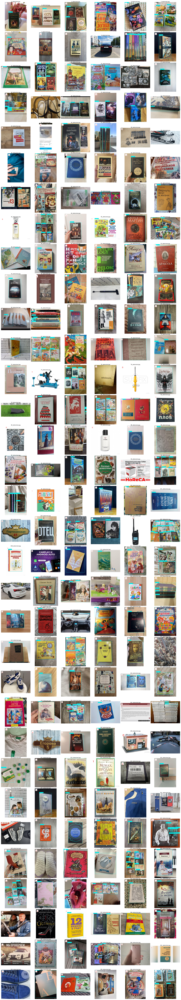

In [131]:
plot_res_images_slice(output_folder, start=0, end=6*33, max_cols=6)

# P.S.

Качество выросло, но предположение, что обученный svm для бинарной классификации книг улучшит качество не подтвердилось. Лучшее качество получилось при таком пайплайне:

```
Классификация(предобученный Resnet+padding)----v
                                                если есть детекции, 
                                                то кол-во книг = кол-во детекций книг, -----> кол-во книг
                                                иначе если классификатор выдал,
                                                что есть книга на фото, то 1 книга
Детекция(RF-DETR)------------------------------^ 
````